# Credit Score Classification

In this project, I will develop a predictive model to determine the type of credit score of a customer based on various parameters. A credit score is based on your credit history, which includes information like the number of accounts, total levels of debt, annual income, and other factors. Here, I will classify the credit score in three categories i.e. "Standard", "Poor" and "Good". By creating a machine learning model, you can help finance companies and banks to segregate the people into credit score brackets to reduce the manual efforts.

## Importing Libraries

In [1]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
from ydata_profiling import ProfileReport

## Importing Dataset

Used 'Filter' option in MS Excel to remove textual data from numeric columns to be able to import the data from csv to pandas dataframe.

In [2]:
dataframe = pd.read_csv('Credit_Score_Classification_edited_data.csv')

## Exploring the Data

In [3]:
dataframe.head()

,ID,Customer_ID,Month,Name,Age,SSN,Occupation,Annual_Income,Monthly_Inhand_Salary,Num_Bank_Accounts,...,Credit_Mix,Outstanding_Debt,Credit_Utilization_Ratio,Credit_History_Age,Payment_of_Min_Amount,Total_EMI_per_month,Amount_invested_monthly,Payment_Behaviour,Monthly_Balance,Credit_Score
0,0x1602,CUS_0xd40,January,Aaron Maashoh,23.0,821-00-0265,Scientist,19114.12,1824.843333,3,...,NaN,809.98,26.822620,22 Years and 1 Months,No,49.574949,80.415295,High_spent_Small_value_payments,312.494089,Good
1,0x1603,CUS_0xd40,February,Aaron Maashoh,23.0,821-00-0265,Scientist,19114.12,NaN,3,...,Good,809.98,31.944960,NaN,No,49.574949,118.280222,Low_spent_Large_value_payments,284.629163,Good
2,0x1604,CUS_0xd40,March,Aaron Maashoh,-500.0,821-00-0265,Scientist,19114.12,NaN,3,...,Good,809.98,28.609352,22 Years and 3 Months,No,49.574949,81.699521,Low_spent_Medium_value_payments,331.209863,Good
3,0x1605,CUS_0xd40,April,Aaron Maashoh,23.0,821-00-0265,Scientist,19114.12,NaN,3,...,Good,809.98,31.377862,22 Years and 4 Months,No,49.574949,199.458074,Low_spent_Small_value_payments,223.451310,Good
4,0x1606,CUS_0xd40,May,Aaron Maashoh,23.0,821-00-0265,Scientist,19114.12,1824.843333,3,...,Good,809.98,24.797347,22 Years and 5 Months,No,49.574949,41.420153,High_spent_Medium_value_payments,341.489231,Good


In [4]:
dataframe.tail()

,ID,Customer_ID,Month,Name,Age,SSN,Occupation,Annual_Income,Monthly_Inhand_Salary,Num_Bank_Accounts,...,Credit_Mix,Outstanding_Debt,Credit_Utilization_Ratio,Credit_History_Age,Payment_of_Min_Amount,Total_EMI_per_month,Amount_invested_monthly,Payment_Behaviour,Monthly_Balance,Credit_Score
99995,0x25fe9,CUS_0x942c,April,Nicks,25.0,078-73-5990,Mechanic,39628.99,3359.415833,4,...,NaN,502.38,34.663572,31 Years and 6 Months,No,35.104023,60.971333,High_spent_Large_value_payments,479.866228,Poor
99996,0x25fea,CUS_0x942c,May,Nicks,25.0,078-73-5990,Mechanic,39628.99,3359.415833,4,...,NaN,502.38,40.565631,31 Years and 7 Months,No,35.104023,54.185950,High_spent_Medium_value_payments,496.651610,Poor
99997,0x25feb,CUS_0x942c,June,Nicks,25.0,078-73-5990,Mechanic,39628.99,3359.415833,4,...,Good,502.38,41.255522,31 Years and 8 Months,No,35.104023,24.028477,High_spent_Large_value_payments,516.809083,Poor
99998,0x25fec,CUS_0x942c,July,Nicks,25.0,078-73-5990,Mechanic,39628.99,3359.415833,4,...,Good,502.38,33.638208,31 Years and 9 Months,No,35.104023,251.672582,Low_spent_Large_value_payments,319.164979,Standard
99999,0x25fed,CUS_0x942c,August,Nicks,25.0,078-73-5990,Mechanic,NaN,3359.415833,4,...,Good,502.38,34.192463,31 Years and 10 Months,No,35.104023,167.163865,NaN,393.673696,Poor


In [5]:
dataframe.shape

(100000, 28)

In [6]:
dataframe.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 100000 entries, 0 to 99999
Data columns (total 28 columns):
 #   Column                    Non-Null Count   Dtype  
---  ------                    --------------   -----  
 0   ID                        100000 non-null  object 
 1   Customer_ID               100000 non-null  object 
 2   Month                     100000 non-null  object 
 3   Name                      90015 non-null   object 
 4   Age                       95061 non-null   float64
 5   SSN                       94428 non-null   object 
 6   Occupation                92938 non-null   object 
 7   Annual_Income             93020 non-null   float64
 8   Monthly_Inhand_Salary     84998 non-null   float64
 9   Num_Bank_Accounts         100000 non-null  int64  
 10  Num_Credit_Card           100000 non-null  int64  
 11  Interest_Rate             100000 non-null  int64  
 12  Num_of_Loan               95215 non-null   float64
 13  Type_of_Loan              88592 non-null   ob

## Data description

1. ID: An identifier for each record in the dataset.
2. Customer_ID: Identifier for individual customers.
3. Month: The month associated with the data entry.
4. Name: Customer's name.
5. Age: Customer's age.
6. SSN: Social Security Number or some other form of identification.
7. Occupation: Customer's occupation or job title.
8. Annual_Income: Customer's annual income.
9. Monthly_Inhand_Salary: The amount of money the customer receives as salary on a monthly basis.
10. Num_Bank_Accounts: Number of bank accounts the customer has.
11. Num_Credit_Card: Number of credit cards the customer possesses.
12. Interest_Rate: The interest rate associated with some financial aspect (e.g., loans or credit cards).
13. Num_of_Loan: Number of loans the customer has.
14. Type_of_Loan: The type of loan(s) the customer has (e.g., mortgage, personal loan, etc.).
15. Delay_from_due_date: Delay in payments from the due date.
16. Num_of_Delayed_Payment: Number of delayed payments.
17. Changed_Credit_Limit: Indicates if the customer has changed their credit limit.
18. Num_Credit_Inquiries: Number of credit inquiries made by the customer.
19. Credit_Mix: The mix of different types of credit accounts (e.g., credit cards, loans).
20. Outstanding_Debt: The amount of outstanding debt.
21. Credit_Utilization_Ratio: The ratio of credit used to the total credit limit.
22. Credit_History_Age: The age of the customer's credit history.
23. Payment_of_Min_Amount: Payment behavior regarding minimum required payments.
24. Total_EMI_per_month: Total Equated Monthly Installment (EMI) payments made by the customer.
25. Amount_invested_monthly: The amount the customer invests on a monthly basis.
26. Payment_Behaviour: Behavior related to payments, possibly indicating patterns or trends.
27. Monthly_Balance: The customer's monthly balance in their financial accounts.
28. Credit_Score: The credit score associated with the customer's creditworthiness.

## Filling Missing Data and Removing the irrelevelant columns

In [7]:
columns = ['ID', 'SSN', 'Name']
for i in columns:
    dataframe.drop(i, axis=1, inplace=True)

In [8]:
dataframe.head()

,Customer_ID,Month,Age,Occupation,Annual_Income,Monthly_Inhand_Salary,Num_Bank_Accounts,Num_Credit_Card,Interest_Rate,Num_of_Loan,...,Credit_Mix,Outstanding_Debt,Credit_Utilization_Ratio,Credit_History_Age,Payment_of_Min_Amount,Total_EMI_per_month,Amount_invested_monthly,Payment_Behaviour,Monthly_Balance,Credit_Score
0,CUS_0xd40,January,23.0,Scientist,19114.12,1824.843333,3,4,3,4.0,...,NaN,809.98,26.822620,22 Years and 1 Months,No,49.574949,80.415295,High_spent_Small_value_payments,312.494089,Good
1,CUS_0xd40,February,23.0,Scientist,19114.12,NaN,3,4,3,4.0,...,Good,809.98,31.944960,NaN,No,49.574949,118.280222,Low_spent_Large_value_payments,284.629163,Good
2,CUS_0xd40,March,-500.0,Scientist,19114.12,NaN,3,4,3,4.0,...,Good,809.98,28.609352,22 Years and 3 Months,No,49.574949,81.699521,Low_spent_Medium_value_payments,331.209863,Good
3,CUS_0xd40,April,23.0,Scientist,19114.12,NaN,3,4,3,4.0,...,Good,809.98,31.377862,22 Years and 4 Months,No,49.574949,199.458074,Low_spent_Small_value_payments,223.451310,Good
4,CUS_0xd40,May,23.0,Scientist,19114.12,1824.843333,3,4,3,4.0,...,Good,809.98,24.797347,22 Years and 5 Months,No,49.574949,41.420153,High_spent_Medium_value_payments,341.489231,Good


In [9]:
dataframe.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 100000 entries, 0 to 99999
Data columns (total 25 columns):
 #   Column                    Non-Null Count   Dtype  
---  ------                    --------------   -----  
 0   Customer_ID               100000 non-null  object 
 1   Month                     100000 non-null  object 
 2   Age                       95061 non-null   float64
 3   Occupation                92938 non-null   object 
 4   Annual_Income             93020 non-null   float64
 5   Monthly_Inhand_Salary     84998 non-null   float64
 6   Num_Bank_Accounts         100000 non-null  int64  
 7   Num_Credit_Card           100000 non-null  int64  
 8   Interest_Rate             100000 non-null  int64  
 9   Num_of_Loan               95215 non-null   float64
 10  Type_of_Loan              88592 non-null   object 
 11  Delay_from_due_date       100000 non-null  int64  
 12  Num_of_Delayed_Payment    90254 non-null   float64
 13  Changed_Credit_Limit      97909 non-null   fl

In [10]:
dataframe_1 = dataframe.copy()

### Filling the Age column using Mode

In [11]:
def custom_mode(series):
    mode_values = series.dropna().mode()
    if mode_values.empty:
        return np.nan
    return mode_values.iloc[0]

In [12]:
age_mode = dataframe_1.groupby('Customer_ID')['Age'].transform(custom_mode)
dataframe_1['Age'] = age_mode

In [13]:
dataframe_1.head()

,Customer_ID,Month,Age,Occupation,Annual_Income,Monthly_Inhand_Salary,Num_Bank_Accounts,Num_Credit_Card,Interest_Rate,Num_of_Loan,...,Credit_Mix,Outstanding_Debt,Credit_Utilization_Ratio,Credit_History_Age,Payment_of_Min_Amount,Total_EMI_per_month,Amount_invested_monthly,Payment_Behaviour,Monthly_Balance,Credit_Score
0,CUS_0xd40,January,23.0,Scientist,19114.12,1824.843333,3,4,3,4.0,...,NaN,809.98,26.822620,22 Years and 1 Months,No,49.574949,80.415295,High_spent_Small_value_payments,312.494089,Good
1,CUS_0xd40,February,23.0,Scientist,19114.12,NaN,3,4,3,4.0,...,Good,809.98,31.944960,NaN,No,49.574949,118.280222,Low_spent_Large_value_payments,284.629163,Good
2,CUS_0xd40,March,23.0,Scientist,19114.12,NaN,3,4,3,4.0,...,Good,809.98,28.609352,22 Years and 3 Months,No,49.574949,81.699521,Low_spent_Medium_value_payments,331.209863,Good
3,CUS_0xd40,April,23.0,Scientist,19114.12,NaN,3,4,3,4.0,...,Good,809.98,31.377862,22 Years and 4 Months,No,49.574949,199.458074,Low_spent_Small_value_payments,223.451310,Good
4,CUS_0xd40,May,23.0,Scientist,19114.12,1824.843333,3,4,3,4.0,...,Good,809.98,24.797347,22 Years and 5 Months,No,49.574949,41.420153,High_spent_Medium_value_payments,341.489231,Good


### Filling Occupation column using Mode

In [14]:
occupation_mode = dataframe_1.groupby('Customer_ID')['Occupation'].transform(custom_mode)
dataframe_1['Occupation'] = occupation_mode

In [15]:
dataframe_1[dataframe_1['Customer_ID']=='CUS_0x21b1']

,Customer_ID,Month,Age,Occupation,Annual_Income,Monthly_Inhand_Salary,Num_Bank_Accounts,Num_Credit_Card,Interest_Rate,Num_of_Loan,...,Credit_Mix,Outstanding_Debt,Credit_Utilization_Ratio,Credit_History_Age,Payment_of_Min_Amount,Total_EMI_per_month,Amount_invested_monthly,Payment_Behaviour,Monthly_Balance,Credit_Score
8,CUS_0x21b1,January,28.0,Teacher,34847.84,3037.986667,2,4,6,1.0,...,Good,605.03,24.464031,26 Years and 7 Months,No,18.816215,104.291825,Low_spent_Small_value_payments,470.690627,Standard
9,CUS_0x21b1,February,28.0,Teacher,34847.84,3037.986667,2,4,6,1.0,...,Good,605.03,38.550848,26 Years and 8 Months,No,18.816215,40.391238,High_spent_Large_value_payments,484.591214,Good
10,CUS_0x21b1,March,28.0,Teacher,NaN,3037.986667,2,1385,6,1.0,...,NaN,605.03,33.224951,26 Years and 9 Months,No,18.816215,58.515976,High_spent_Large_value_payments,466.466476,Standard
11,CUS_0x21b1,April,28.0,Teacher,34847.84,NaN,2,4,6,1.0,...,Good,605.03,39.182656,26 Years and 10 Months,No,18.816215,99.306228,Low_spent_Medium_value_payments,465.676224,Good
12,CUS_0x21b1,May,28.0,Teacher,34847.84,3037.986667,2,4,6,1.0,...,Good,605.03,34.977895,26 Years and 11 Months,No,18.816215,130.115420,Low_spent_Small_value_payments,444.867032,Good
13,CUS_0x21b1,June,28.0,Teacher,34847.84,3037.986667,2,4,6,1.0,...,Good,605.03,33.381010,27 Years and 0 Months,No,18.816215,43.477190,High_spent_Large_value_payments,481.505262,Good
14,CUS_0x21b1,July,28.0,Teacher,34847.84,NaN,2,4,6,1.0,...,Good,605.03,31.131702,27 Years and 1 Months,NM,18.816215,70.101774,High_spent_Medium_value_payments,464.880678,Good
15,CUS_0x21b1,August,28.0,Teacher,34847.84,3037.986667,2,4,6,1.0,...,Good,605.03,32.933856,27 Years and 2 Months,No,18.816215,218.904344,Low_spent_Small_value_payments,356.078109,Good


### Filling Num_Bank_Accounts column using Mode

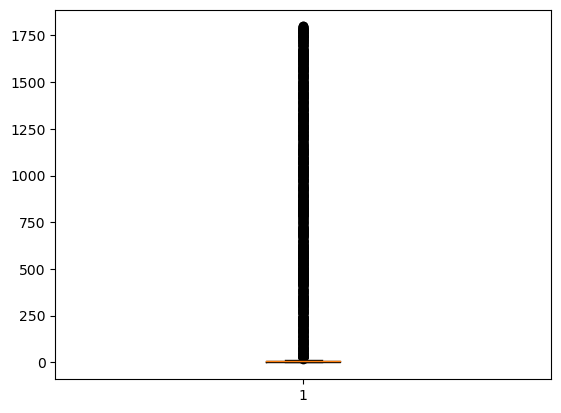

In [16]:
plt.boxplot(dataframe_1['Num_Bank_Accounts'])
plt.show()

In [17]:
num_of_bank_accounts_mode = dataframe_1.groupby('Customer_ID')['Num_Bank_Accounts'].transform(custom_mode)
dataframe_1['Num_Bank_Accounts'] = num_of_bank_accounts_mode

### Filling Num_Credit_Card column using Mode

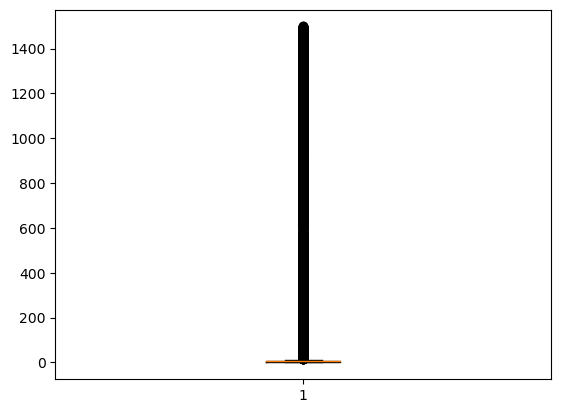

In [18]:
plt.boxplot(dataframe_1['Num_Credit_Card'])
plt.show()

In [19]:
num_of_credit_cards_mode = dataframe_1.groupby('Customer_ID')['Num_Credit_Card'].transform(custom_mode)
dataframe_1['Num_Credit_Card'] = num_of_credit_cards_mode

### Filling Interest_Rate column using Mode

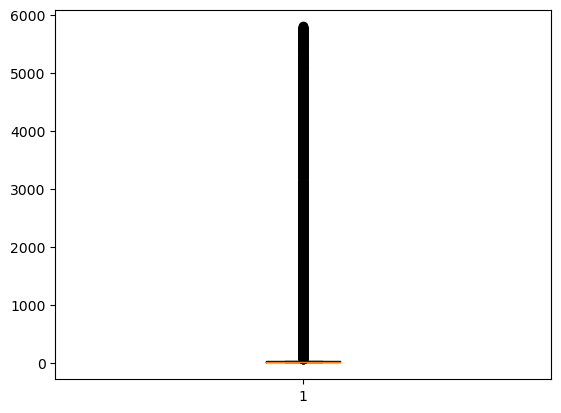

In [20]:
plt.boxplot(dataframe_1['Interest_Rate'])
plt.show()

In [21]:
interest_rate_mode = dataframe_1.groupby('Customer_ID')['Interest_Rate'].transform(custom_mode)
dataframe_1['Interest_Rate'] = interest_rate_mode

### Filling Num_of_Loan column using Mode

In [22]:
num_of_loan_mode = dataframe_1.groupby('Customer_ID')['Num_of_Loan'].transform(custom_mode)
dataframe_1['Num_of_Loan'] = num_of_loan_mode

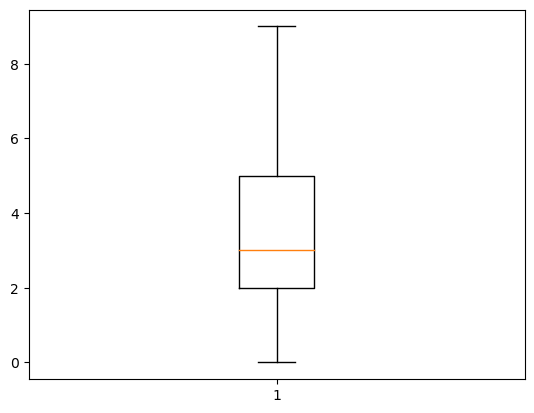

In [23]:
plt.boxplot(dataframe_1['Num_of_Loan'])
plt.show()

### Filling Num_of_Delayed_Payment using Interpolation

In [24]:
dataframe_1['Num_of_Delayed_Payment'] = dataframe_1.groupby('Customer_ID')['Num_of_Delayed_Payment'].transform(lambda x: x.interpolate(method='index', limit_direction='both') if x.count() > 1 else x)

In [25]:
dataframe_1.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 100000 entries, 0 to 99999
Data columns (total 25 columns):
 #   Column                    Non-Null Count   Dtype  
---  ------                    --------------   -----  
 0   Customer_ID               100000 non-null  object 
 1   Month                     100000 non-null  object 
 2   Age                       100000 non-null  float64
 3   Occupation                100000 non-null  object 
 4   Annual_Income             93020 non-null   float64
 5   Monthly_Inhand_Salary     84998 non-null   float64
 6   Num_Bank_Accounts         100000 non-null  int64  
 7   Num_Credit_Card           100000 non-null  int64  
 8   Interest_Rate             100000 non-null  int64  
 9   Num_of_Loan               100000 non-null  float64
 10  Type_of_Loan              88592 non-null   object 
 11  Delay_from_due_date       100000 non-null  int64  
 12  Num_of_Delayed_Payment    100000 non-null  float64
 13  Changed_Credit_Limit      97909 non-null   fl

### Filling Changed_Credit_Limit column using Interpolation

In [26]:
dataframe_1['Changed_Credit_Limit'] = dataframe_1.groupby('Customer_ID')['Changed_Credit_Limit'].transform(lambda x: x.interpolate(method='index', limit_direction='both') if x.count() > 1 else x)

In [27]:
dataframe_1[dataframe_1['Customer_ID']=='CUS_0x4157'][['Changed_Credit_Limit']]

,Changed_Credit_Limit
64,8.24
65,8.24
66,8.24
67,8.24
68,11.24
69,8.24
70,8.24
71,8.24


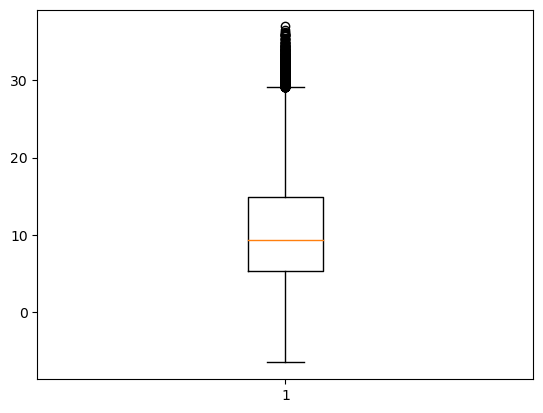

In [28]:
plt.boxplot(dataframe_1['Changed_Credit_Limit'])
plt.show()

### Filling Num_Credit_Inquiries using Mode

In [29]:
num_of_credit_enquiries_mode = dataframe_1.groupby('Customer_ID')['Num_Credit_Inquiries'].transform(custom_mode)
dataframe_1['Num_Credit_Inquiries'] = num_of_credit_enquiries_mode

In [30]:
dataframe_1[dataframe_1['Customer_ID']=='CUS_0xa16e'][['Num_Credit_Inquiries']]

,Num_Credit_Inquiries
168,6.0
169,6.0
170,6.0
171,6.0
172,6.0
173,6.0
174,6.0
175,6.0


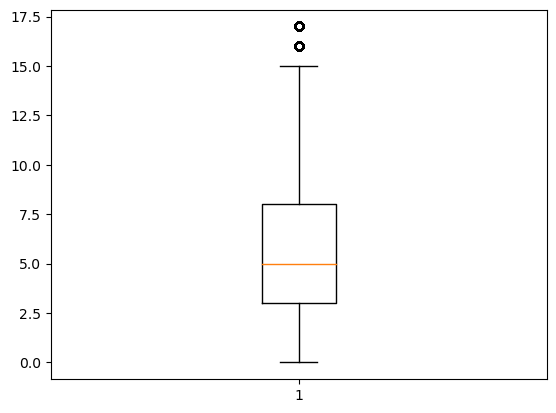

In [31]:
plt.boxplot(dataframe_1['Num_Credit_Inquiries'])
plt.show()

### Filling Credit_Mix column using Mode

In [32]:
credit_mix_mode = dataframe_1.groupby('Customer_ID')['Credit_Mix'].transform(custom_mode)
dataframe_1['Credit_Mix'] = dataframe_1['Credit_Mix'].fillna(credit_mix_mode)

### Filling Outstanding_Debt column using Interpolation

In [33]:
dataframe_1['Outstanding_Debt'] = dataframe_1.groupby('Customer_ID')['Outstanding_Debt'].transform(lambda x: x.interpolate(method='index', limit_direction='both') if x.count() > 1 else x)

### Converting Credit_History_Age to No. of months using custom function

In [34]:
def Month_Converter(x):
    if pd.notnull(x):
        num1 = int(x.split(' ')[0])
        num2 = int(x.split(' ')[3])
      
        return (num1*12)+num2
    else:
        return x

In [35]:
dataframe_1.Credit_History_Age = dataframe_1.Credit_History_Age.apply(lambda x: Month_Converter(x)).astype(np.float64)

### Filling Credit_History_Age column using Interpolation

In [36]:
dataframe_1['Credit_History_Age'] = dataframe_1.groupby('Customer_ID')['Credit_History_Age'].transform( lambda x: x.interpolate(method='index', limit_direction='both') if x.count() > 1 else x)

### Filling Annual_Income column using Interpolation

In [37]:
dataframe_1['Annual_Income'] = dataframe_1.groupby('Customer_ID')['Annual_Income'].transform(lambda x: x.interpolate(method='index', limit_direction='both') if x.count() > 1 else x)

### Filling Monthly_Inhand_Salary column using Interpolation

In [38]:
dataframe_1['Monthly_Inhand_Salary'] = dataframe_1.groupby('Customer_ID')['Monthly_Inhand_Salary'].transform(lambda x: x.interpolate(method='index', limit_direction='both') if x.count() > 1 else x)

### Correlation HeatMap

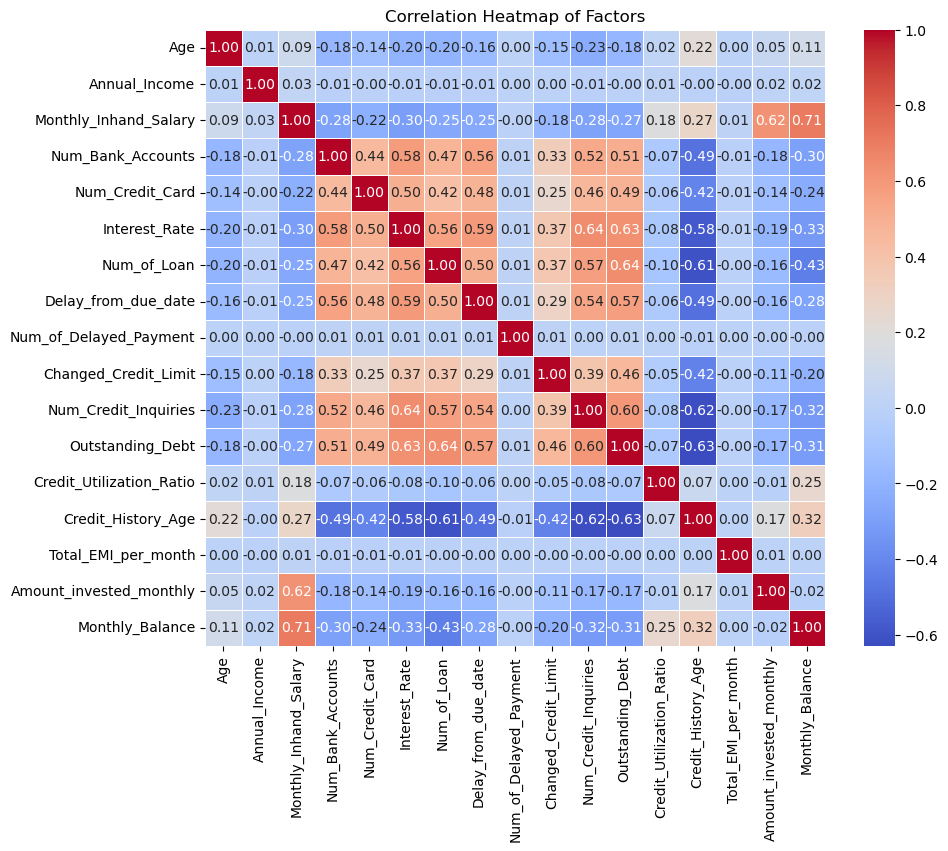

In [39]:
selected_columns = dataframe_1.select_dtypes(include=['number'])
correlation_matrix = selected_columns.corr()

plt.figure(figsize=(10, 8))
sns.heatmap(correlation_matrix, annot=True, cmap='coolwarm', fmt=".2f", linewidths=0.5)
plt.title('Correlation Heatmap of Factors')
plt.show()

Since Monthly_Inhand_Salary and Amount_invested_monthly are highly correlated, we can fill Amount_invested_monthly using the Monthly_Inhand_Salary column.

### Filling Amount_invested_monthly using Mode grouping by Monthly_Inhand_Salary

In [40]:
amount_invested_monthly = dataframe_1.groupby('Monthly_Inhand_Salary')['Amount_invested_monthly'].transform(custom_mode)
dataframe_1['Amount_invested_monthly'] = dataframe_1['Amount_invested_monthly'].fillna(amount_invested_monthly)

In [41]:
amount_invested_monthly = dataframe_1.groupby('Customer_ID')['Amount_invested_monthly'].transform(custom_mode)
dataframe_1['Amount_invested_monthly'] = dataframe_1['Amount_invested_monthly'].fillna(amount_invested_monthly)

### Filling Monthly_Balance using Mode grouping by Monthly_Inhand_Salary

In [42]:
monthly_balance = dataframe_1.groupby('Monthly_Inhand_Salary')['Monthly_Balance'].transform(custom_mode)
dataframe_1['Monthly_Balance'] = dataframe_1['Monthly_Balance'].fillna(monthly_balance)

In [43]:
monthly_balance = dataframe_1.groupby('Customer_ID')['Monthly_Balance'].transform(custom_mode)
dataframe_1['Monthly_Balance'] = dataframe_1['Monthly_Balance'].fillna(monthly_balance)

### Filling Payment_Behaviour column using Mode

In [44]:
payment_behaviour_mode = dataframe_1.groupby('Customer_ID')['Payment_Behaviour'].transform(custom_mode)
dataframe_1['Payment_Behaviour'] = dataframe_1['Payment_Behaviour'].fillna(payment_behaviour_mode)

In [45]:
dataframe_1.head()

,Customer_ID,Month,Age,Occupation,Annual_Income,Monthly_Inhand_Salary,Num_Bank_Accounts,Num_Credit_Card,Interest_Rate,Num_of_Loan,...,Credit_Mix,Outstanding_Debt,Credit_Utilization_Ratio,Credit_History_Age,Payment_of_Min_Amount,Total_EMI_per_month,Amount_invested_monthly,Payment_Behaviour,Monthly_Balance,Credit_Score
0,CUS_0xd40,January,23.0,Scientist,19114.12,1824.843333,3,4,3,4.0,...,Good,809.98,26.822620,265.0,No,49.574949,80.415295,High_spent_Small_value_payments,312.494089,Good
1,CUS_0xd40,February,23.0,Scientist,19114.12,1824.843333,3,4,3,4.0,...,Good,809.98,31.944960,266.0,No,49.574949,118.280222,Low_spent_Large_value_payments,284.629163,Good
2,CUS_0xd40,March,23.0,Scientist,19114.12,1824.843333,3,4,3,4.0,...,Good,809.98,28.609352,267.0,No,49.574949,81.699521,Low_spent_Medium_value_payments,331.209863,Good
3,CUS_0xd40,April,23.0,Scientist,19114.12,1824.843333,3,4,3,4.0,...,Good,809.98,31.377862,268.0,No,49.574949,199.458074,Low_spent_Small_value_payments,223.451310,Good
4,CUS_0xd40,May,23.0,Scientist,19114.12,1824.843333,3,4,3,4.0,...,Good,809.98,24.797347,269.0,No,49.574949,41.420153,High_spent_Medium_value_payments,341.489231,Good


### Dropping Type_of_Loan column because it is string based irrelevelant

In [46]:
dataframe_1.drop('Type_of_Loan' , axis=1, inplace=True)

## Data Analysis using PandasProfiling

In [47]:
dataframe_2 = dataframe_1.copy()

In [48]:
profile = ProfileReport(dataframe_2)
profile

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

In [49]:
dataframe_2.drop('Customer_ID', axis=1, inplace=True)

In [50]:
dataframe_2.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 100000 entries, 0 to 99999
Data columns (total 23 columns):
 #   Column                    Non-Null Count   Dtype  
---  ------                    --------------   -----  
 0   Month                     100000 non-null  object 
 1   Age                       100000 non-null  float64
 2   Occupation                100000 non-null  object 
 3   Annual_Income             100000 non-null  float64
 4   Monthly_Inhand_Salary     100000 non-null  float64
 5   Num_Bank_Accounts         100000 non-null  int64  
 6   Num_Credit_Card           100000 non-null  int64  
 7   Interest_Rate             100000 non-null  int64  
 8   Num_of_Loan               100000 non-null  float64
 9   Delay_from_due_date       100000 non-null  int64  
 10  Num_of_Delayed_Payment    100000 non-null  float64
 11  Changed_Credit_Limit      100000 non-null  float64
 12  Num_Credit_Inquiries      100000 non-null  float64
 13  Credit_Mix                100000 non-null  ob

## Encoding

In [51]:
dataframe_2.Month = pd.to_datetime(dataframe_2.Month,format="%B").dt.month
dataframe_2.Month = dataframe_2.Month.astype(np.int64)

In [52]:
from sklearn.preprocessing import LabelEncoder
dataframe_2['Credit_Score'] = LabelEncoder().fit_transform(dataframe_2['Credit_Score'])

In [53]:
import category_encoders as ce
columns = ['Payment_of_Min_Amount','Payment_Behaviour','Occupation','Credit_Mix']
for item in columns:
    dataframe_2[item] = ce.LeaveOneOutEncoder().fit_transform(dataframe_2[item],dataframe_2['Credit_Score'])
dataframe_2.head()

,Month,Age,Occupation,Annual_Income,Monthly_Inhand_Salary,Num_Bank_Accounts,Num_Credit_Card,Interest_Rate,Num_of_Loan,Delay_from_due_date,...,Credit_Mix,Outstanding_Debt,Credit_Utilization_Ratio,Credit_History_Age,Payment_of_Min_Amount,Total_EMI_per_month,Amount_invested_monthly,Payment_Behaviour,Monthly_Balance,Credit_Score
0,1,23.0,1.338277,19114.12,1824.843333,3,4,3,4.0,3,...,0.863016,809.98,26.822620,265.0,1.099647,49.574949,80.415295,1.355789,312.494089,0
1,2,23.0,1.338277,19114.12,1824.843333,3,4,3,4.0,-1,...,0.863016,809.98,31.944960,266.0,1.099647,49.574949,118.280222,1.359256,284.629163,0
2,3,23.0,1.338277,19114.12,1824.843333,3,4,3,4.0,3,...,0.863016,809.98,28.609352,267.0,1.099647,49.574949,81.699521,1.337825,331.209863,0
3,4,23.0,1.338277,19114.12,1824.843333,3,4,3,4.0,5,...,0.863016,809.98,31.377862,268.0,1.099647,49.574949,199.458074,1.385327,223.451310,0
4,5,23.0,1.338277,19114.12,1824.843333,3,4,3,4.0,6,...,0.863016,809.98,24.797347,269.0,1.099647,49.574949,41.420153,1.343971,341.489231,0


In [54]:
columns2 =['Annual_Income','Age','Num_Credit_Card','Interest_Rate','Delay_from_due_date','Num_of_Delayed_Payment','Monthly_Balance',
                           'Num_Credit_Inquiries','Changed_Credit_Limit','Credit_History_Age',
                           'Outstanding_Debt','Total_EMI_per_month']
for item in columns2:
    mean_encoding = dataframe_2.groupby([item])['Credit_Score'].mean()
    dataframe_2[item] = dataframe_2[item].map(mean_encoding)
dataframe_2.head()

,Month,Age,Occupation,Annual_Income,Monthly_Inhand_Salary,Num_Bank_Accounts,Num_Credit_Card,Interest_Rate,Num_of_Loan,Delay_from_due_date,...,Credit_Mix,Outstanding_Debt,Credit_Utilization_Ratio,Credit_History_Age,Payment_of_Min_Amount,Total_EMI_per_month,Amount_invested_monthly,Payment_Behaviour,Monthly_Balance,Credit_Score
0,1,1.369269,1.338277,0.25,1824.843333,3,1.370815,0.910057,4.0,0.892645,...,0.863016,0.25,26.822620,1.289593,1.099647,0.25,80.415295,1.355789,0.0,0
1,2,1.369269,1.338277,0.25,1824.843333,3,1.370815,0.910057,4.0,0.790476,...,0.863016,0.25,31.944960,1.279070,1.099647,0.25,118.280222,1.359256,0.0,0
2,3,1.369269,1.338277,0.25,1824.843333,3,1.370815,0.910057,4.0,0.892645,...,0.863016,0.25,28.609352,1.206767,1.099647,0.25,81.699521,1.337825,0.0,0
3,4,1.369269,1.338277,0.25,1824.843333,3,1.370815,0.910057,4.0,1.203813,...,0.863016,0.25,31.377862,1.252830,1.099647,0.25,199.458074,1.385327,0.0,0
4,5,1.369269,1.338277,0.25,1824.843333,3,1.370815,0.910057,4.0,1.261077,...,0.863016,0.25,24.797347,1.208791,1.099647,0.25,41.420153,1.343971,0.0,0


In [ ]:
profile = ProfileReport(dataframe_2)
profile

Reduced Correlation between categories

## Modeling

In [56]:
dataframe_3 = dataframe_2.copy()

In [57]:
X = dataframe_3.drop(['Credit_Score'], axis=1)
Y = dataframe_3.Credit_Score

### Doing Synthetic Minority Oversampling Technique because of class imbalance of Target variable

In [58]:
from imblearn.over_sampling import SMOTE
smote = SMOTE()
X, Y = smote.fit_resample(X, Y)

In [59]:
from sklearn.model_selection import train_test_split
X_train, X_test, y_train, y_test = train_test_split(X, Y, test_size=0.33, shuffle=True, random_state=42)

### Using Standard Scaler for scaling the input features

In [60]:
from sklearn.preprocessing import StandardScaler
scaler = StandardScaler()
features = X_train.columns
X_train = scaler.fit_transform(X_train)
X_train = pd.DataFrame(X_train, columns=features)
X_test = scaler.transform(X_test)
X_test = pd.DataFrame(X_test, columns=features)
X_train.head()

,Month,Age,Occupation,Annual_Income,Monthly_Inhand_Salary,Num_Bank_Accounts,Num_Credit_Card,Interest_Rate,Num_of_Loan,Delay_from_due_date,...,Num_Credit_Inquiries,Credit_Mix,Outstanding_Debt,Credit_Utilization_Ratio,Credit_History_Age,Payment_of_Min_Amount,Total_EMI_per_month,Amount_invested_monthly,Payment_Behaviour,Monthly_Balance
0,0.292869,0.548535,0.895028,-0.227614,-0.838144,-0.369383,0.057694,1.187323,0.676796,1.058151,...,1.711069,1.131862,0.377923,-1.410203,0.680982,0.035115,0.367092,-0.621597,1.436938,-0.002369
1,1.222650,0.548535,2.923250,0.383368,2.305140,-1.132960,0.563344,-1.739129,-0.178422,-0.117540,...,-0.123604,-1.195814,0.377923,-0.682443,0.337215,-1.153807,0.367092,0.356386,-0.410866,-0.002369
2,-1.566693,0.002503,0.802299,-1.461917,0.541430,-1.132960,0.191770,-0.184498,0.210334,-0.164162,...,-0.164655,-1.195719,-1.471481,0.248554,-1.318271,-1.153664,-1.496906,0.096756,0.067162,-1.230674
3,-1.566693,0.387950,0.887838,1.401673,0.454233,-1.514749,0.057694,-0.130801,0.249187,-0.281251,...,-0.791632,-1.195909,1.419389,0.514761,0.107537,-1.153949,1.445164,-0.269178,0.111824,1.225936
4,1.687540,0.444177,-0.900008,-0.227614,0.151304,0.394195,0.624210,0.179025,1.959622,0.135058,...,1.362232,0.263963,-0.246956,0.581923,1.401117,0.035115,-0.279751,1.269934,-0.686123,-0.002369


In [61]:
model_names = []
accuracy_scores = []
precision_scores = []
recall_scores = []
f1_scores = []
train_scores = []
test_scores = []

In [62]:
from sklearn.metrics import classification_report, precision_score, recall_score, accuracy_score, f1_score, ConfusionMatrixDisplay
def train_and_evaluate_model(model):
    model.fit(X_train,y_train)
    y_pred = model.predict(X_test)
    print(classification_report(y_test,y_pred))
    acc = accuracy_score(y_test,y_pred)
    y_pred_train = model.predict(X_train)
    y_pred_test = model.predict(X_test)
    train_acc = accuracy_score(y_train, y_pred_train)
    test_acc = accuracy_score(y_test, y_pred_test)
    print("Train Accuracy:", train_acc)
    print("Test Accuracy:", test_acc)
    precision = precision_score(y_test,y_pred,average='micro')
    recall = recall_score(y_test,y_pred,average='micro')
    f1 = f1_score(y_test,y_pred,average='micro')
    ConfusionMatrixDisplay.from_predictions(y_test,y_pred)
    plt.show();
    model_names.append(model)
    accuracy_scores.append(acc)
    precision_scores.append(precision)
    recall_scores.append(recall)
    f1_scores.append(f1)
    train_scores.append(train_acc)
    test_scores.append(test_acc)

### Using 3 different classifiers for modeling

              precision    recall  f1-score   support

           0       1.00      1.00      1.00     17491
           1       1.00      1.00      1.00     17613
           2       1.00      1.00      1.00     17539

    accuracy                           1.00     52643
   macro avg       1.00      1.00      1.00     52643
weighted avg       1.00      1.00      1.00     52643

Train Accuracy: 1.0
Test Accuracy: 0.999772049465266


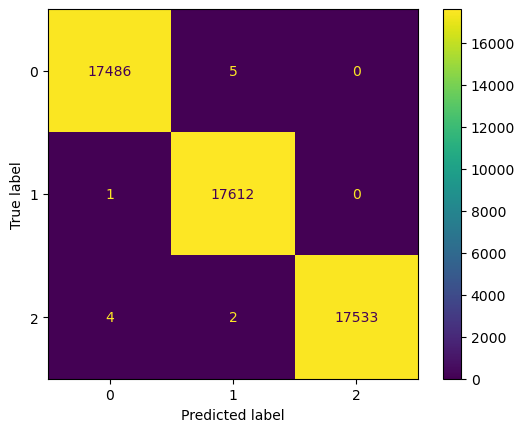

In [63]:
from sklearn.ensemble import RandomForestClassifier
train_and_evaluate_model(RandomForestClassifier())

D:\ProgramData\anaconda3\Lib\site-packages\sklearn\svm\_base.py:1244: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(


              precision    recall  f1-score   support

           0       0.99      1.00      0.99     17491
           1       1.00      0.98      0.99     17613
           2       0.98      1.00      0.99     17539

    accuracy                           0.99     52643
   macro avg       0.99      0.99      0.99     52643
weighted avg       0.99      0.99      0.99     52643

Train Accuracy: 0.9900167479111893
Test Accuracy: 0.9901411393727562


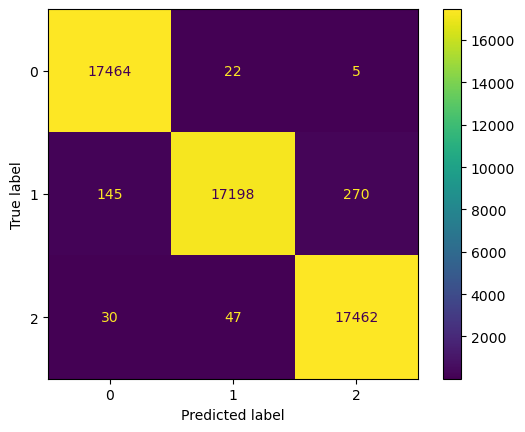

In [64]:
from sklearn.svm import LinearSVC
train_and_evaluate_model(LinearSVC())

              precision    recall  f1-score   support

           0       1.00      1.00      1.00     17491
           1       0.99      1.00      1.00     17613
           2       1.00      1.00      1.00     17539

    accuracy                           1.00     52643
   macro avg       1.00      1.00      1.00     52643
weighted avg       1.00      1.00      1.00     52643

Train Accuracy: 0.9970808110105821
Test Accuracy: 0.9968086925137245


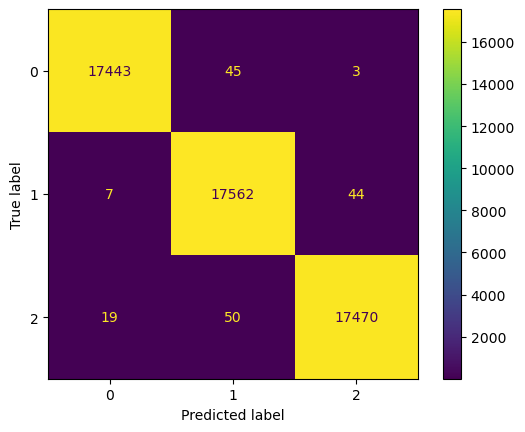

In [65]:
from sklearn.linear_model import LogisticRegression
train_and_evaluate_model(LogisticRegression())

In [66]:
model_names

[RandomForestClassifier(), LinearSVC(), LogisticRegression()]

### Comparing the results

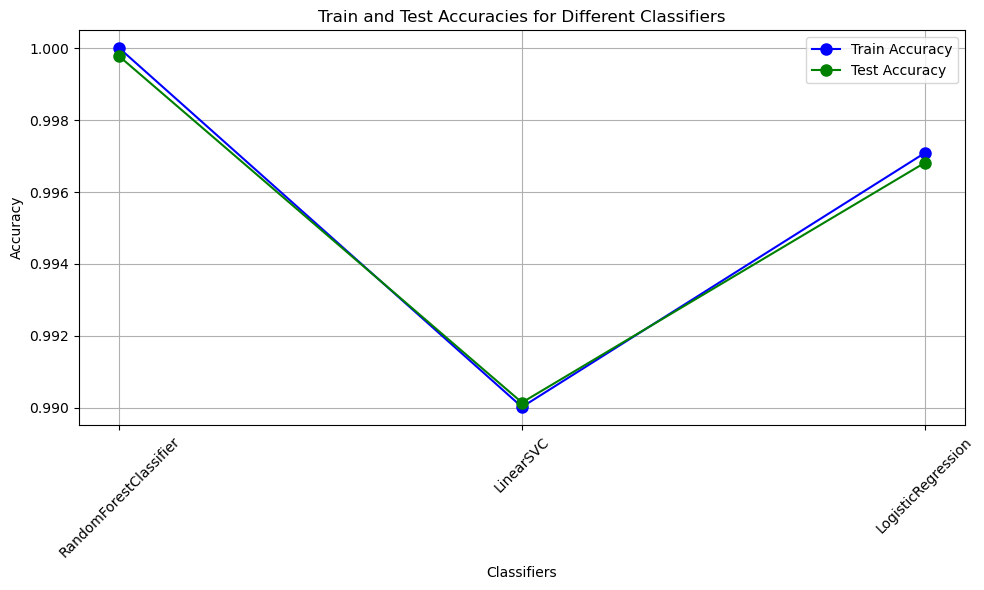

In [67]:
classifiers = ['RandomForestClassifier', 'LinearSVC', 'LogisticRegression']
plt.figure(figsize=(10, 6))
plt.plot(classifiers, train_scores, marker='o', label='Train Accuracy', linestyle='-', color='b', markersize=8)
plt.plot(classifiers, test_scores, marker='o', label='Test Accuracy', linestyle='-', color='g', markersize=8)

# Add labels and legend
plt.xlabel('Classifiers')
plt.ylabel('Accuracy')
plt.title('Train and Test Accuracies for Different Classifiers')
plt.legend()

# Rotate x-axis labels for better readability
plt.xticks(rotation=45)

# Show the plot
plt.grid(True)
plt.tight_layout()
plt.show()

# End